# Predicting Crime & Safety: Los Angeles Crime Data Analysis and Visualization
#### CSC 457/557 (Data Analysis, Decision Making, and Visualization)
#### Final Project of Fall-2023
#### Al-Amin Hossain

## Libraries

In [92]:
import pandas as pd
import missingno as msno
import numpy as np
import matplotlib.pyplot as pyplot
import seaborn as sns
import sklearn
import pickle
import calendar
import statsmodels.api as sm
import itertools
import timeit
import folium
import math

from matplotlib.pylab import rcParams
from sklearn.model_selection import train_test_split
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.ar_model import AutoReg
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

pd.options.display.max_columns = 50
%matplotlib inline
# ignore warnings
from warnings import filterwarnings
filterwarnings('ignore')

## Data Loading

In [2]:
# reading the data using pandas
df = pd.read_csv("Crime_Data_from_2020_to_Present.csv")

In [3]:
# showing laoded data
df.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545
2,200110444,04/14/2020 12:00:00 AM,02/13/2020 12:00:00 AM,1200,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,1501,0,X,X,726.0,POLICE FACILITY,NaN,NaN,AA,Adult Arrest,845.0,NaN,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474
3,191501505,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,76,F,W,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,IC,Invest Cont,745.0,998.0,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019
4,191921269,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0329,31,X,X,409.0,BEAUTY SUPPLY STORE,NaN,NaN,IC,Invest Cont,740.0,NaN,NaN,NaN,14400 TITUS ST,NaN,34.2198,-118.4468


## Data Cleaning

In [4]:
# checking the number of row and colums
df.shape

(798242, 28)

In [5]:
# checking the columns name, data-count for each column and data type
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 798242 entries, 0 to 798241
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           798242 non-null  int64  
 1   Date Rptd       798242 non-null  object 
 2   DATE OCC        798242 non-null  object 
 3   TIME OCC        798242 non-null  int64  
 4   AREA            798242 non-null  int64  
 5   AREA NAME       798242 non-null  object 
 6   Rpt Dist No     798242 non-null  int64  
 7   Part 1-2        798242 non-null  int64  
 8   Crm Cd          798242 non-null  int64  
 9   Crm Cd Desc     798242 non-null  object 
 10  Mocodes         688290 non-null  object 
 11  Vict Age        798242 non-null  int64  
 12  Vict Sex        693589 non-null  object 
 13  Vict Descent    693581 non-null  object 
 14  Premis Cd       798233 non-null  float64
 15  Premis Desc     797770 non-null  object 
 16  Weapon Used Cd  277895 non-null  float64
 17  Weapon Des

In [6]:
# Removing unnecessary column
df = df.drop(columns={'Date Rptd', 'Rpt Dist No', 'Status', 'Status Desc', 'LOCATION',
                      'Part 1-2', 'Cross Street', 'Mocodes', 'Crm Cd 1', 'Crm Cd 2',
                      'Crm Cd 3', 'Crm Cd 4'})

In [7]:
# Renaming colmun
df = df.rename(columns={
    'DR_NO': 'DRNumber',
    'DATE OCC': 'DateOccurred',
    'TIME OCC': 'TimeOccurred',
    'AREA': 'AreaID',
    'AREA NAME': 'AreaName',
    'Crm Cd': 'CrimeCode',
    'Crm Cd Desc': 'CrimeCodeDescription',
    'Vict Age': 'VictimAge',
    'Vict Sex': 'VictimSex',
    'Vict Descent': 'VictimDescent',
    'Premis Cd': 'PremiseCode',
    'Premis Desc': 'PremiseDescription',
    'Weapon Used Cd': 'WeaponUsedCode',
    'Weapon Desc': 'WeaponDescription',
    'LAT': 'Lat',
    'LON': 'Lon'
})

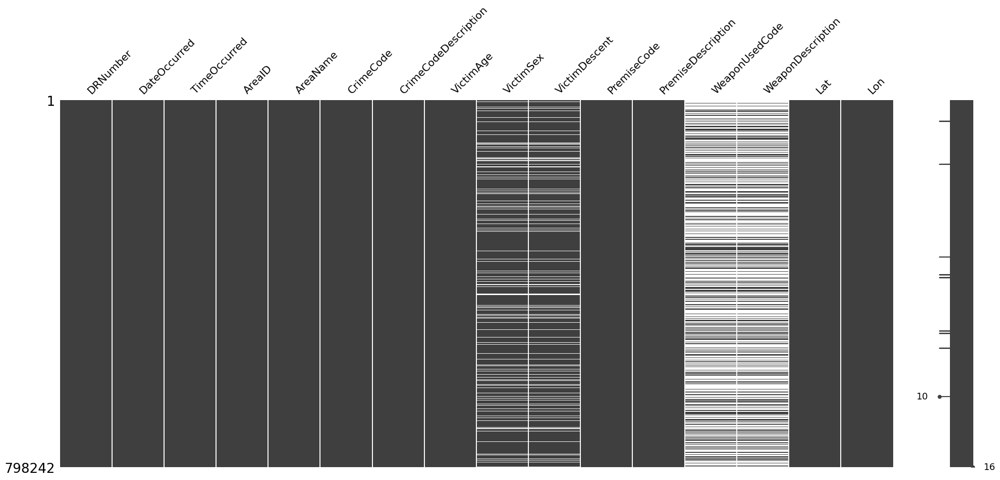

In [8]:
# using missingo library to check the missing and available data visually
# Dark squares: Data is present. 
# Light squares: Data is missing.
msno.matrix(df)
pyplot.show()

In [9]:
# checking for null values count for each column
df.isna().sum()

DRNumber                     0
DateOccurred                 0
TimeOccurred                 0
AreaID                       0
AreaName                     0
CrimeCode                    0
CrimeCodeDescription         0
VictimAge                    0
VictimSex               104653
VictimDescent           104661
PremiseCode                  9
PremiseDescription         472
WeaponUsedCode          520347
WeaponDescription       520347
Lat                          0
Lon                          0
dtype: int64

#### Converting the Reported and Occured date and time into time series index

In [10]:
# removing empty time stamp from Date Reported and Date Ocurred
df["DateOccurred"] = df["DateOccurred"].str.replace('T00:00:00', '')

In [11]:
# setting 'date occured' column as datetime object
df['DateOccurred'] = pd.to_datetime(df['DateOccurred'], format= '%m/%d/%Y %I:%M:%S %p')

In [12]:
# sorting according to Date Occurred
df = df.set_index('DateOccurred').sort_index()

In [13]:
# showing the first three row
df.tail(5)

,DRNumber,TimeOccurred,AreaID,AreaName,CrimeCode,CrimeCodeDescription,VictimAge,VictimSex,VictimDescent,PremiseCode,PremiseDescription,WeaponUsedCode,WeaponDescription,Lat,Lon
DateOccurred,,,,,,,,,,,,,,,
2023-09-11,232114033,1130,21,Topanga,330,BURGLARY FROM VEHICLE,0,NaN,NaN,108.0,PARKING LOT,NaN,NaN,34.1845,-118.5928
2023-09-11,231914018,630,19,Mission,510,VEHICLE - STOLEN,0,NaN,NaN,101.0,STREET,NaN,NaN,34.2355,-118.4553
2023-09-11,231417078,1120,14,Pacific,442,SHOPLIFTING - PETTY THEFT ($950 & UNDER),0,NaN,NaN,404.0,DEPARTMENT STORE,NaN,NaN,33.9978,-118.4605
2023-09-11,232114024,1130,21,Topanga,330,BURGLARY FROM VEHICLE,0,NaN,NaN,108.0,PARKING LOT,NaN,NaN,34.1845,-118.5928
2023-09-11,231317117,900,13,Newton,624,BATTERY - SIMPLE ASSAULT,58,F,H,935.0,MTA - BLUE LINE - WASHINGTON,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",34.0207,-118.2432


Now that we have the dataframe converted to a format for time series analysis, we can do basic data cleaning steps.  

#### Filling up the null values of Premise Code and Premise Description 

In [14]:
# replace the null values of Premise Code with 0
df['PremiseCode'].fillna(0, inplace = True)

# replace the null values of Premise Description with UNKNOWN
df['PremiseDescription'].fillna('UNKNOWN', inplace = True)

In [15]:
# checking if Premise Code have null values or not
df['PremiseCode'].isna().any()

False

In [16]:
# checking if Premise Description have null values or not
df['PremiseDescription'].isna().any()

False

9 null values from Premise Code and 472 values of Premise Description have been replaced with 0 and Unknown respectively

#### Checking for Outliers in Victim Age column and removing those

We can see that Victim Age has no null value. Checking for Outliers using boxplot visualization.

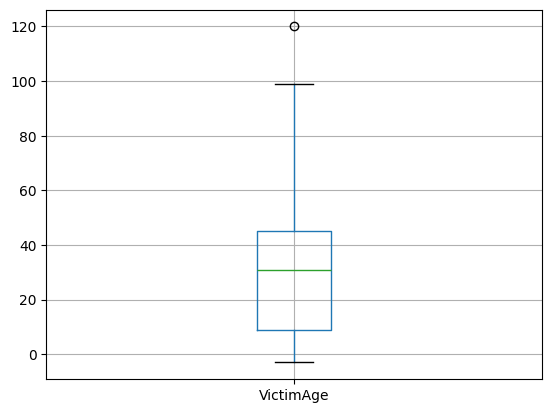

In [17]:
figure = df.boxplot(column='VictimAge')
pyplot.show()

Here we can see that there are few rows which have VictimAge below zero and 1 row has age 120.
Victim Age below zero is impossible. So, these are outliers. I will remove those rows.
Although, 120 is not impossible but I am considering this as outliers too. I will remove this too.

In [18]:
# total count
df['VictimAge'].count()

798242

In [19]:
# checking the count of rows which have values less than 0
below_0 = df[df['VictimAge'] < 0].count()
below_0['VictimAge']

68

In [20]:
# removing the rows which have Victim Age less than 0
df = df[df['VictimAge'] >= 0]

In [21]:
# total count
df['VictimAge'].count()

798174

In [22]:
# checking the count of rows which have values grater than 100
above_100 = df[df['VictimAge'] > 100].count()
above_100['VictimAge']

1

In [23]:
# removing the rows which have Victim Age grater than 100
df = df[df['VictimAge'] < 100]

In [24]:
# total count
df['VictimAge'].count()

798173

In [25]:
# re-checking if there is any null value
df['VictimAge'].isna().sum()

0

#### Checking the Count of Victim Sex, Types and replace those according to need

In [26]:
# type of Victim Sex and count
df['VictimSex'].value_counts()

VictimSex
M    330086
F    294367
X     68979
H        88
-         1
Name: count, dtype: int64

In [27]:
# Here, the data set has 104653 null values, replacing those with X
df['VictimSex'].fillna('X', inplace=True)

# Here, replacing 'H', '-' with X
df['VictimSex'].replace(to_replace=['H', '-'], value='X', inplace = True)

In [28]:
# type of Victim Sex and the count after replacing
df['VictimSex'].value_counts()

VictimSex
M    330086
F    294367
X    173720
Name: count, dtype: int64

In [29]:
# checking if there is any Sex out of expectations
df['VictimSex'].unique()

array(['F', 'M', 'X'], dtype=object)

#### Checking the Count of Victim Descent, Types and replace those according to need

In [30]:
# type of Victim Descent and count
df['VictimDescent'].value_counts()

VictimDescent
H    245080
W    163052
B    114044
X     76278
O     63324
A     17437
K      4258
F      3326
C      3040
J      1105
V       826
I       758
Z       402
P       214
U       165
D        57
G        52
L        49
S        44
-         2
Name: count, dtype: int64

In [31]:
# replacing the '-' into 'X'
df['VictimDescent'].replace(to_replace=['-'], value='X', inplace = True)

In [32]:
# Here, the data set has 104661 null values, replacing those with X`
df['VictimDescent'].fillna('X`', inplace= True)

In [33]:
# re-checking if there is any null value
df['VictimDescent'].isna().sum()

0

In [34]:
# type of Victim Descent and count after replacing the values
df['VictimDescent'].value_counts()

VictimDescent
H     245080
W     163052
B     114044
X`    104660
X      76280
O      63324
A      17437
K       4258
F       3326
C       3040
J       1105
V        826
I        758
Z        402
P        214
U        165
D         57
G         52
L         49
S         44
Name: count, dtype: int64

In [35]:
# Desecent Description 
descent_dict ={'A': 'Other Asian', 'B': 'Black', 'C': 'Chinese',
               'D': 'Cambodian', 'F': 'Filipino', 'G': 'Guamanian',
               'H': 'Latinx', 'I': 'Native', 'J': 'Japanese', 
               'K': 'Korean', 'L': 'Laotian', 'O': 'Other',
               'P': 'Pacific Islander', 'S': 'Samoan', 'U': 'Hawaiian',
               'V': 'Vietnamese', 'W': 'White',  'X': 'Unknown', 'X`':'Null Unknown', 'Z':'Asian Indian'}

#### Checking the Weapon Used Code and Weapon Description and replace those according to need

In [36]:
# the data set has 520347 null values for Weapon Used Code and Weapon Description
# replacing the null value fo Weapon Used Code with 0
df['WeaponUsedCode'].fillna(0, inplace = True)

# replacing the null value of Weapon Description with UNKNOWN
df['WeaponDescription'].fillna('UNKNOWN', inplace = True)

In [37]:
# re-checking if there is any null value
df['WeaponUsedCode'].isna().sum()

0

In [38]:
# re-checking if there is any null value
df['WeaponDescription'].isna().sum()

0

#### Checking the Crime Code and Crime Code Description

In [39]:
# Checking the unique count of Crime Code
df['CrimeCode'].value_counts().count()

138

In [40]:
# Checking the unique count of Crime Code Description
df['CrimeCodeDescription'].value_counts().count()

138

#### Checking the Area ID and Area Name

In [41]:
# Checking the unique count of Aread ID
df['AreaID'].value_counts().count()

21

In [42]:
# Checking the unique count of Aread Name
df['AreaName'].value_counts().count()

21

#### All the cleaned and checked features

In [43]:
cleaned_features = ['DRNumber', 'TimeOccurred', 'AreaID', 'AreaName'
                    , 'CrimeCode', 'CrimeCodeDescription', 'VictimAge',
                    'VictimSex', 'VictimDescent', 'PremiseCode', 'PremiseDescription',
                    'WeaponUsedCode', 'WeaponDescription', 'Lat', 'Lon']

In [44]:
# Saving cleaned data into cleaned_df
cleaned_df = df[cleaned_features]

In [45]:
# checking for null values count for each column
cleaned_df.isna().sum()

DRNumber                0
TimeOccurred            0
AreaID                  0
AreaName                0
CrimeCode               0
CrimeCodeDescription    0
VictimAge               0
VictimSex               0
VictimDescent           0
PremiseCode             0
PremiseDescription      0
WeaponUsedCode          0
WeaponDescription       0
Lat                     0
Lon                     0
dtype: int64

## Data Visualization

###  Which Areas in LA have the Highest Crime Rate?

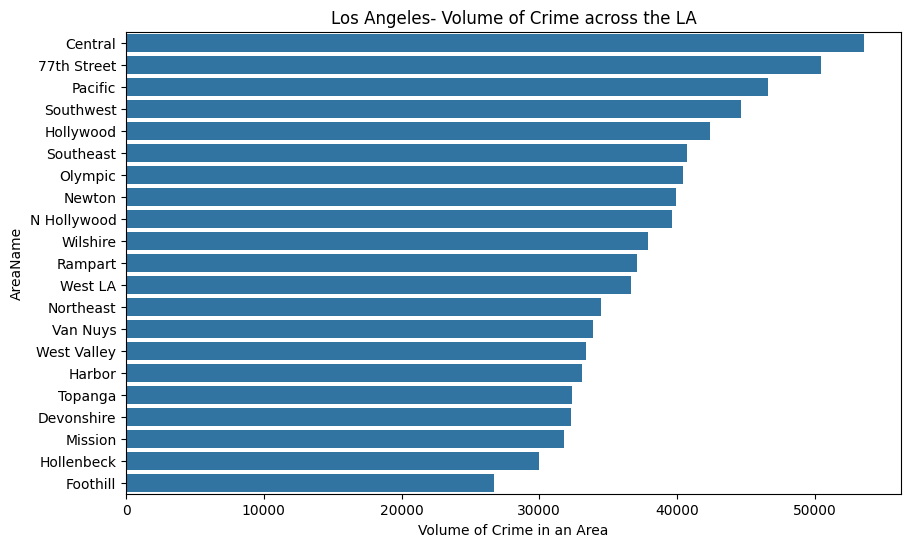

In [46]:
# Setting up figure
pyplot.figure(figsize=(10,6))

# Plotting categorial count plot for crime by area
sns.countplot(y='AreaName', data= cleaned_df, orient="h", order=cleaned_df['AreaName'].value_counts().index)

# Setting x axis label and figure title
pyplot.xlabel('Volume of Crime in an Area')
pyplot.title('Los Angeles- Volume of Crime across the LA');


In [47]:
cleaned_df['AreaName'].value_counts()[:5]

AreaName
Central        53599
77th Street    50449
Pacific        46626
Southwest      44645
Hollywood      42406
Name: count, dtype: int64

The top 5 areas where most of the crimes in LA haver occured Central, 77th Street, Pacific, Southwest, and Hollywood.

In [48]:
# creating crime_df with each unique crime and associated area name
crime_df = cleaned_df[['DRNumber','AreaName']]

# renaming columns
crime_df.rename(columns={"DRNumber": "IncidentID", 'AreaName':'Area'}, inplace=True)

# creating crime_counts_df with the count of crime in each area
crime_counts_df = crime_df.groupby('Area').size().reset_index()
crime_counts_df = crime_counts_df.rename({0: 'num_crimes'}, axis='columns')

# fixing area names so they appear on the map
crime_counts_df['Area'] = crime_counts_df['Area'].str.replace('N Hollywood', 'North Hollywood')
crime_counts_df['Area'] = crime_counts_df['Area'].str.replace('West LA', 'West Los Angeles')

In [49]:
LAgeo = r'LAPD_Divisions.json'

mapLACrimes = folium.Map(
    location=[34.052235, -118.243683], 
    zoom_start=10, 
    tiles='cartodbpositron'
)

folium.Choropleth(
    geo_data=LAgeo,
    name='Choropleth',
    data=crime_counts_df,
    columns=['Area', 'num_crimes'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Reported Crimes in LA from 2020-2023',
).add_to(mapLACrimes)

mapLACrimes

                             Map Showing different Area with Colors according to Crime Count

## Which Months are most Crime Prone? Which day of the Week? Which time of the Day? 

### Month of Crime

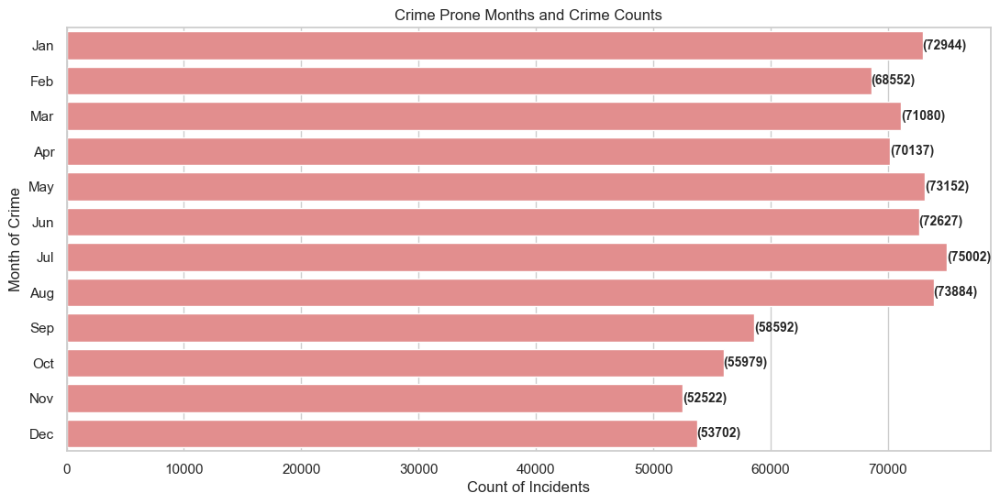

In [50]:
# extracting the month from the 'DateOccurred' column and creating a 'MonthOfCrime' column
cleaned_df['MonthOfCrime'] = cleaned_df.index.month

# grouping by 'MonthOfCrime' and calculating the count of incidents
summary_for_month = cleaned_df.groupby('MonthOfCrime')['MonthOfCrime'].count().reset_index(name='CountIncidents')

# reordering the 'MonthOfCrime' column based on the count of incidents
summary_for_month['MonthOfCrime'] = summary_for_month['MonthOfCrime'].map(lambda x: calendar.month_abbr[x])

# creating a bar chart using seaborn
sns.set(style='whitegrid')
pyplot.figure(figsize=(13, 6))
sns.barplot(x='CountIncidents', y='MonthOfCrime', data=summary_for_month, color='lightcoral', legend=False)

# adding text labels to the bars
for index, row in summary_for_month.iterrows():
    pyplot.text(row.CountIncidents, row.MonthOfCrime, f'({row.CountIncidents})', va='center', fontsize=10, fontweight='bold')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Month of Crime')
pyplot.title('Crime Prone Months and Crime Counts')

# show the plot
pyplot.show()

July and August have the highest crime occurance count.
In contrast, We can observe that November and December have the lowest Crime Incidents count.

### Day of Crime

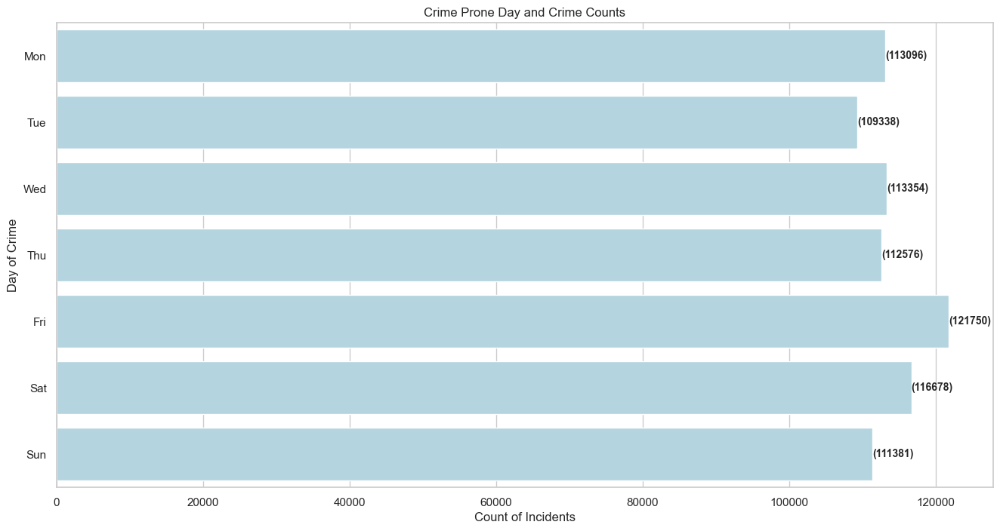

In [51]:
# creating a dictionary to map day names to their abbreviated forms
day_order = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
day_abbr_dict = {
    'Monday': 'Mon',
    'Tuesday': 'Tue',
    'Wednesday': 'Wed',
    'Thursday': 'Thu',
    'Friday': 'Fri',
    'Saturday': 'Sat',
    'Sunday': 'Sun'
}

# extracting the day of the week from the 'DateOccurred' column and create a 'DayOfCrime' column
cleaned_df['DayOfCrime'] = cleaned_df.index.day_name()

# mapping the day names to their abbreviated forms
cleaned_df['DayOfCrime'] = cleaned_df['DayOfCrime'].map(day_abbr_dict)

# specifing the order of days
cleaned_df['DayOfCrime'] = pd.Categorical(cleaned_df['DayOfCrime'], categories=day_order, ordered=True)

# grouping by 'DayOfCrime' and calculate the count of incidents
summary_for_day = cleaned_df.groupby('DayOfCrime').size().reset_index(name='CountIncidents')

# creating a bar chart using seaborn
sns.set(style='whitegrid')
pyplot.figure(figsize=(16,8))
sns.barplot(x='CountIncidents', y='DayOfCrime', data=summary_for_day, color='lightblue', legend=False)

# adding text labels to the bars
for index, row in summary_for_day.iterrows():
    pyplot.text(row.CountIncidents, row.DayOfCrime, f'({row.CountIncidents})', va='center', fontsize=10, fontweight='bold')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Day of Crime')
pyplot.title('Crime Prone Day and Crime Counts')

# Show the plot
pyplot.show()

We observe that Friday has the highest and Tuesday has the lowest crime count.

### Time of Crime
#### Most Crimes

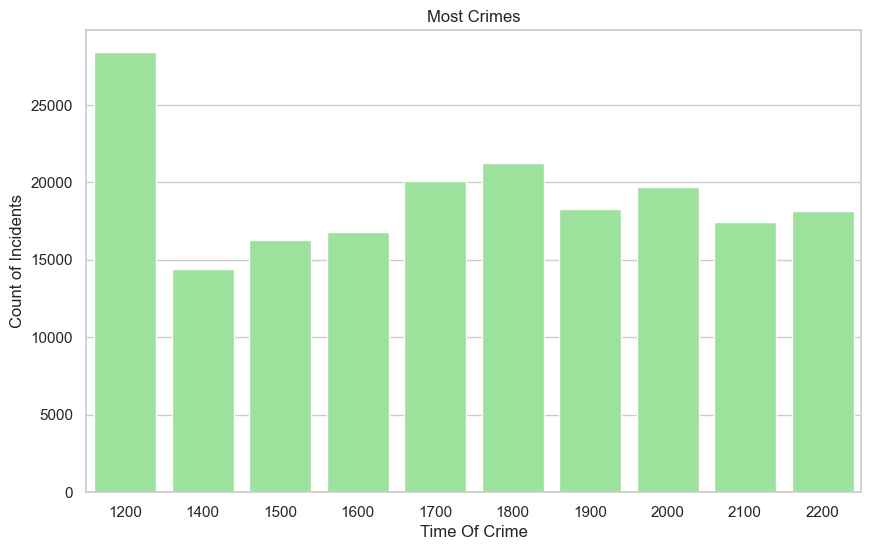

In [52]:
# grouping by 'TimeOccurred' and calculating the count of incidents
summary = cleaned_df.groupby('TimeOccurred').size().reset_index(name='CountIncidents')

# arranging in descending order by CountIncidents
summary = summary.sort_values(by='CountIncidents', ascending=False)

# converting 'TimeOccurred' to integers (assuming it's in a numeric format)
summary['TimeOccurred'] = summary['TimeOccurred'].astype(int)

# selecting the top 10 rows
summary_for_most_crimes = summary.head(10)

# creating a bar chart using seaborn
sns.set(style='whitegrid')
pyplot.figure(figsize=(10, 6))
sns.barplot(x='TimeOccurred', y='CountIncidents', data=summary_for_most_crimes, color='lightgreen')

# adding labels and title
pyplot.ylabel('Count of Incidents')
pyplot.xlabel('Time Of Crime')
pyplot.title('Most Crimes')

# Show the plot
pyplot.show()

The plot shows the hours of the day where most crimes occur. Crimes occur mostly at 1200 hrs. Very Strange!, 
why would someone commit crime so much at the middle of the day, rather than at night.

### Least Crimes

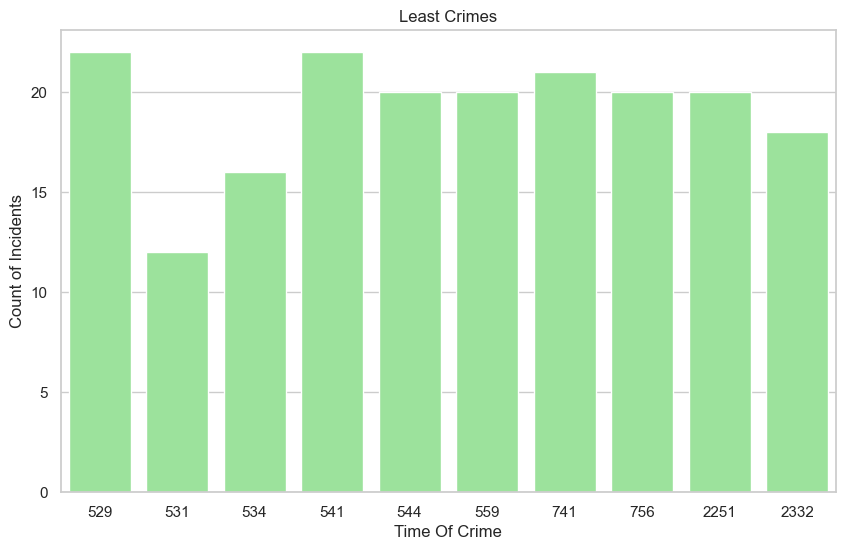

In [53]:
# selecting the last 10 rows
summary_for_least_crimes = summary.tail(10)

# creating a bar chart using seaborn
sns.set(style='whitegrid')
pyplot.figure(figsize=(10, 6))
sns.barplot(x='TimeOccurred', y='CountIncidents', data=summary_for_least_crimes, color='lightgreen')

# adding labels and title
pyplot.ylabel('Count of Incidents')
pyplot.xlabel('Time Of Crime')
pyplot.title('Least Crimes')

# show the plot
pyplot.show()

Crimes occur least at round 700 hrs. Is it because, people have woken up and getting ready for crime? This is really interesting.

### Type of Crimes at 12:00

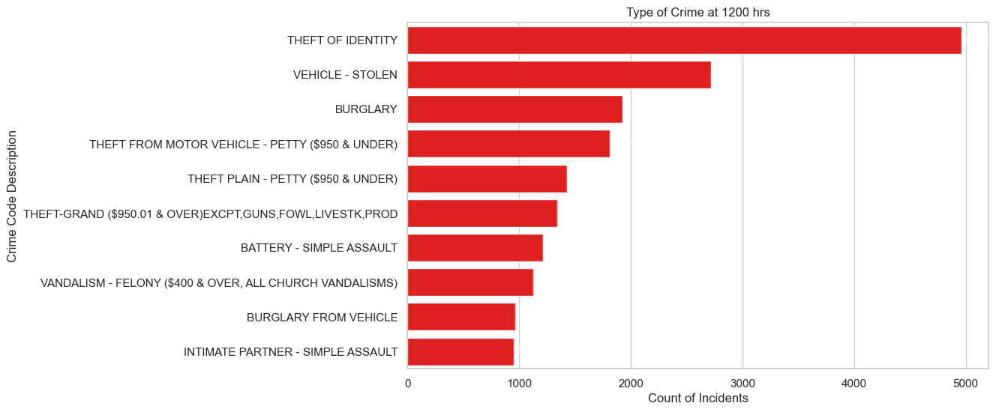

In [54]:
# filtering the DataFrame for TimeOccurred == 1200
filtered_data = cleaned_df[cleaned_df['TimeOccurred'] == 1200]

# grouping by 'CrimeCodeDescription' and calculating the count of incidents
summary_crime_types = filtered_data.groupby('CrimeCodeDescription').size().reset_index(name='CountIncidents')

# sorting the DataFrame by CountIncidents in descending order and select the top 10 rows
summary_crime_types = summary_crime_types.sort_values(by='CountIncidents', ascending=False).head(10)

# creating a horizontal bar chart using seaborn
sns.set(style="whitegrid")
pyplot.figure(figsize=(10, 6))
sns.barplot(x='CountIncidents', y='CrimeCodeDescription', data=summary_crime_types, color='red')

# adding text labels to the bars
for index, row in summary_crime_types.iterrows():
    pyplot.text(row.CountIncidents, row.CrimeCodeDescription, f"({row.CountIncidents})", ha='left', va='center', fontsize=10, fontweight='bold', color='white')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Crime Code Description')
pyplot.title('Type of Crime at 1200 hrs')

# show the plot
pyplot.show()

Theft of Identity is the most common crime type which happens during this time.

## Is there any connection between Crime Count, Age and Sex of the Victims?

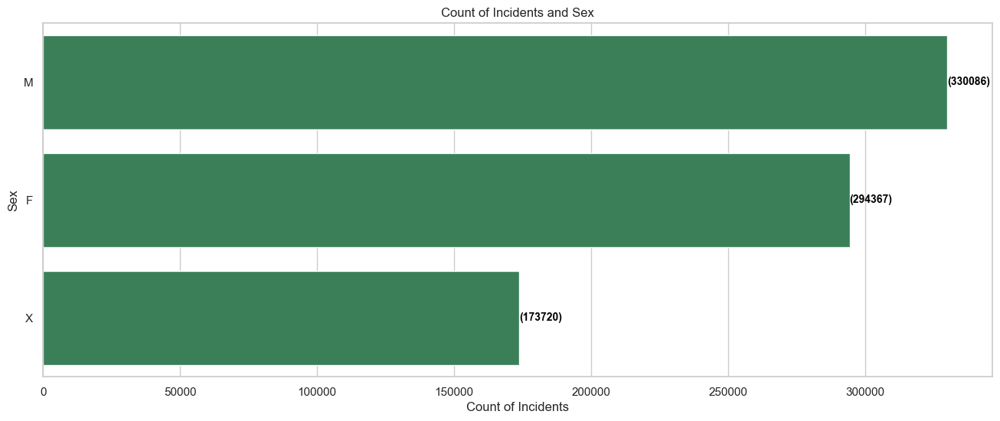

In [55]:
# grouping by 'VictimSex' and calculate the count of incidents
summary_sex_of_the_victims = cleaned_df['VictimSex'].value_counts().reset_index()
summary_sex_of_the_victims.columns = ['VictimSex', 'n']

# creating a horizontal bar chart using seaborn
sns.set(style="whitegrid")
pyplot.figure(figsize=(16, 6))
sns.barplot(x='n', y='VictimSex', data=summary_sex_of_the_victims, color='seagreen')

# adding text labels to the bars
for index, row in summary_sex_of_the_victims.iterrows():
    pyplot.text(row.n, row.VictimSex, f"({row.n})", ha='left', va='center', fontsize=10, fontweight='bold', color='black')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Sex')
pyplot.title('Count of Incidents and Sex')

# Show the plot
pyplot.show()

### Sex and Types of Crime

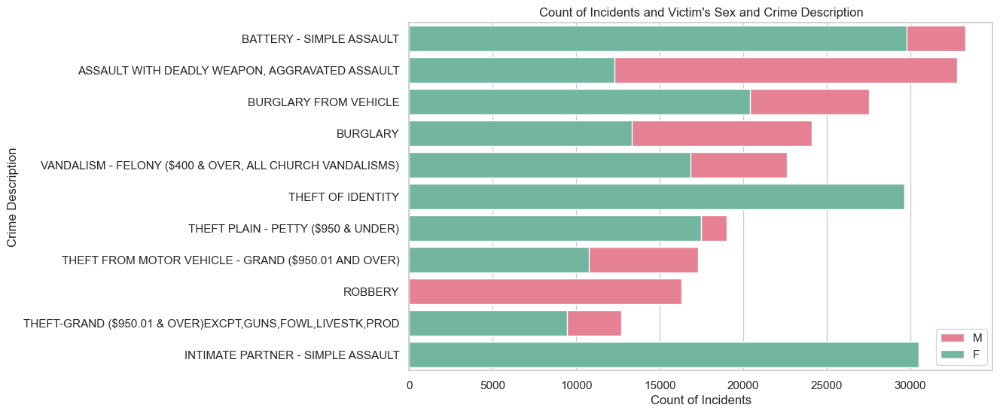

In [56]:
# grouping by 'VictimSex' and 'CrimeCodeDescription' and calculate the count of incidents
summary_d = cleaned_df.groupby(['VictimSex', 'CrimeCodeDescription']).size().reset_index(name='n')

# sorting the DataFrame by 'n' in descending order
summary_d = summary_d.sort_values(by='n', ascending=False)

# selecting the top 10 rows for each VictimSex
male_summary = summary_d[summary_d['VictimSex'] == 'M'].head(10)
female_summary = summary_d[summary_d['VictimSex'] == 'F'].head(10)

# creating separate bar plots for male and female victims
pyplot.figure(figsize=(10, 6))
sns.set(style="whitegrid")
sns.barplot(x='n', y='CrimeCodeDescription', data=male_summary, hue='VictimSex', palette='husl', dodge=False)
sns.barplot(x='n', y='CrimeCodeDescription', data=female_summary, hue='VictimSex', palette='Set2', dodge=False)

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Crime Description')
pyplot.title('Count of Incidents and Victim\'s Sex and Crime Description')

# adding legend position to 'lower right'
pyplot.legend(loc='lower right')

# show the plot
pyplot.show()

We observe for Females we have the Category Intimate Partner - Simple Assault and Theft of Identity which we do not have for Males.

### Age and Sex of the Victims

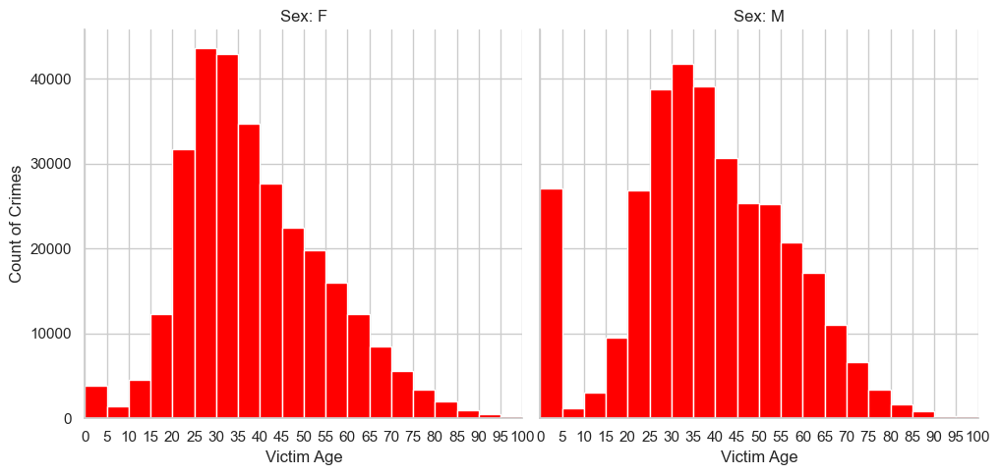

In [57]:
breaks = range(0, 101, 5)
list_sex = ["M", "F"]

# filtering out the unknown sex, considering only Male and Female
filtered_data = cleaned_df[cleaned_df['VictimSex'].isin(list_sex)]

# creating a facet plot with histograms for different sexes
g = sns.FacetGrid(filtered_data, col="VictimSex", height=5)
g.map(pyplot.hist, "VictimAge", bins=breaks, color="red")

# adding limits and breaks of x-axis
g.set(xlim=(0, 100))
g.set(xticks=breaks)

# adding labels and title
g.set_axis_labels("Victim Age", "Count of Crimes")
g.set_titles(col_template="Sex: {col_name}")

# show the plot
pyplot.show()

Most Victims are around the age 25 to 30.It is evident that Females are Victimised more than Males in the age group 25 to 30.

### Crime Types for person age 70 and above

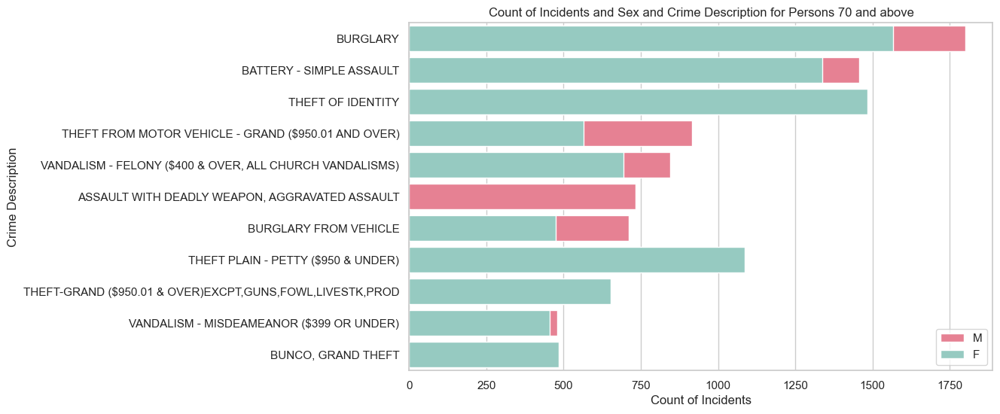

In [58]:
# filtering out rows those with VictimAge >= 70
filtered_data = cleaned_df[cleaned_df['VictimAge'] >= 70]

# group by 'VictimSex' and 'CrimeCodeDescription' and calculating the count of incidents
summary_above = filtered_data.groupby(['VictimSex', 'CrimeCodeDescription']).size().reset_index(name='n')

# sorting the DataFrame by 'n' in descending order
summary_above = summary_above.sort_values(by='n', ascending=False)

# selecting the top 10 rows for each VictimSex
male_summary = summary_above[summary_above['VictimSex'] == 'M'].head(10)
female_summary = summary_above[summary_above['VictimSex'] == 'F'].head(10)

# creating separate bar plots for male and female victims
pyplot.figure(figsize=(10, 6))
sns.set(style="whitegrid")
sns.barplot(x='n', y='CrimeCodeDescription', data=male_summary, hue='VictimSex', palette='husl', dodge=False)
sns.barplot(x='n', y='CrimeCodeDescription', data=female_summary, hue='VictimSex', palette='Set3', dodge=False)

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Crime Description')
pyplot.title('Count of Incidents and Sex and Crime Description for Persons 70 and above')

# adding legend position to 'top'
pyplot.legend(loc='lower right')

# show the plot
pyplot.show()

We observer that Burglary is the Two Important Crime Types commited with persons aged 70 and above.

## What are the Premises that have most crime count?

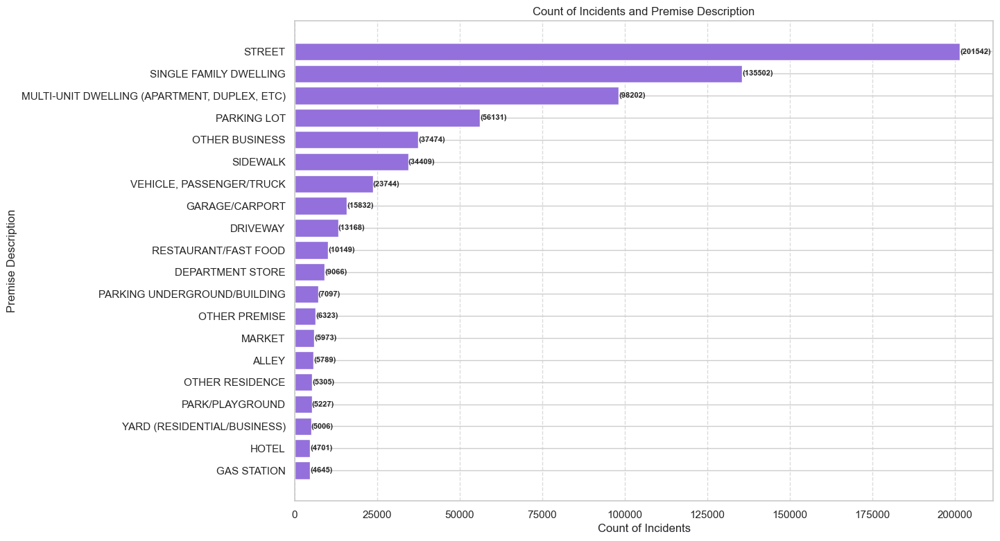

In [59]:
# grouping by 'PremiseDescription' and calculate the count of incidents
summary_crime_premises = cleaned_df['PremiseDescription'].value_counts().reset_index()
summary_crime_premises.columns = ['PremiseDescription', 'n']

# sorting the DataFrame by 'n' in descending order and select the top 20 rows
summary_crime_premises = summary_crime_premises.sort_values(by='n', ascending=False).head(20)

# creating the bar plot
pyplot.figure(figsize=(13, 9))
pyplot.barh(summary_crime_premises['PremiseDescription'], summary_crime_premises['n'], color='mediumpurple')

# adding count labels to the bars
for index, value in enumerate(summary_crime_premises['n']):
    pyplot.text(value, index, f"({value})", va='center', fontsize=8, fontweight='bold')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Premise Description')
pyplot.title('Count of Incidents and Premise Description')

# show the plot
pyplot.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top
pyplot.grid(axis='x', linestyle='--', alpha=0.7)
pyplot.show()

Street, Single family dwelling , Multi unit bwelling, Parking lot rank among the top places for Crimes.

### Type of Crime at differet Premises

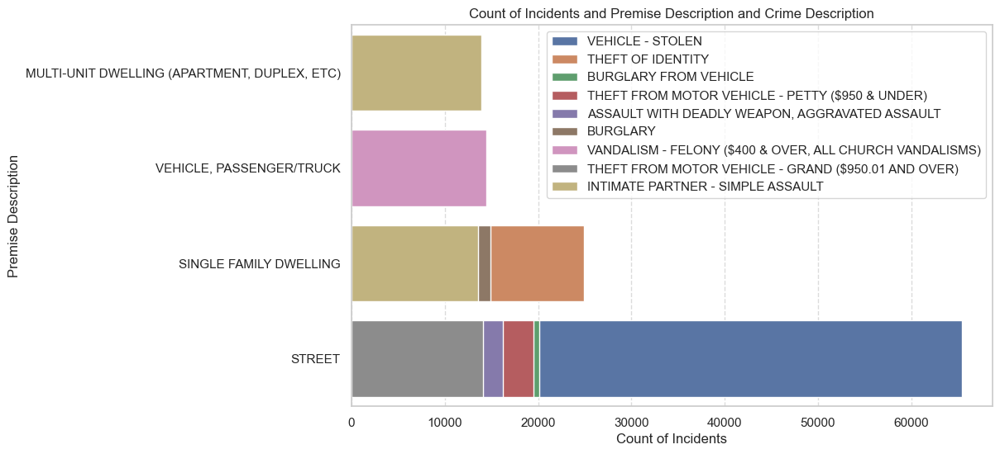

In [60]:
# grouping by 'PremiseDescription' and 'CrimeCodeDescription' and calculating the count of incidents
summary_crime_pr = cleaned_df.groupby(['PremiseDescription', 'CrimeCodeDescription']).size().reset_index(name='n')

# sorting the DataFrame by 'n' in descending order and select the top 10 rows
summary_crime_pr = summary_crime_pr.sort_values(by='n', ascending=False).head(10)

# creating the bar plot
pyplot.figure(figsize=(10, 6))
sns.set(style="whitegrid")
sns.barplot(x='n', y='PremiseDescription', data=summary_crime_pr, hue='CrimeCodeDescription', dodge=False)

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Premise Description')
pyplot.title('Count of Incidents and Premise Description and Crime Description')

# adding legend position to 'top'
pyplot.legend(loc='upper right')

# show the plot
pyplot.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top
pyplot.grid(axis='x', linestyle='--', alpha=0.7)
pyplot.show()

Stolen Vehicle, Theft from Motor Vehicle and Burglary from Vehicle are most common Crime Types in the Street. Theft of Identity, Intimate Partner and Burglary are most common Crime Types in the Single Family Dwelling.

## What are the Top 3 Impacted Demographics in LA?

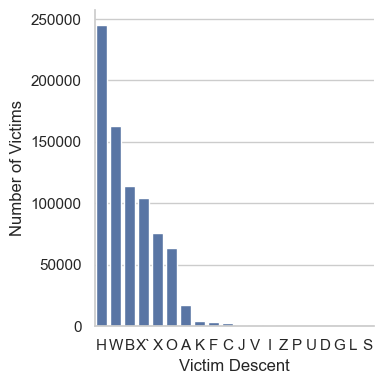

In [61]:
# Plotting  a countplot of Victim Descent
cou = cleaned_df['VictimDescent'].value_counts().index
g = sns.catplot(x=cleaned_df['VictimDescent'], 
                data=cleaned_df, 
                kind='count', 
                height=4, 
                orient='h', order=cleaned_df['VictimDescent'].value_counts().index)

#setting y label
g.set_ylabels('Number of Victims')
g.set_xlabels('Victim Descent')
g.set_titles('Distribution of victims by Descent');

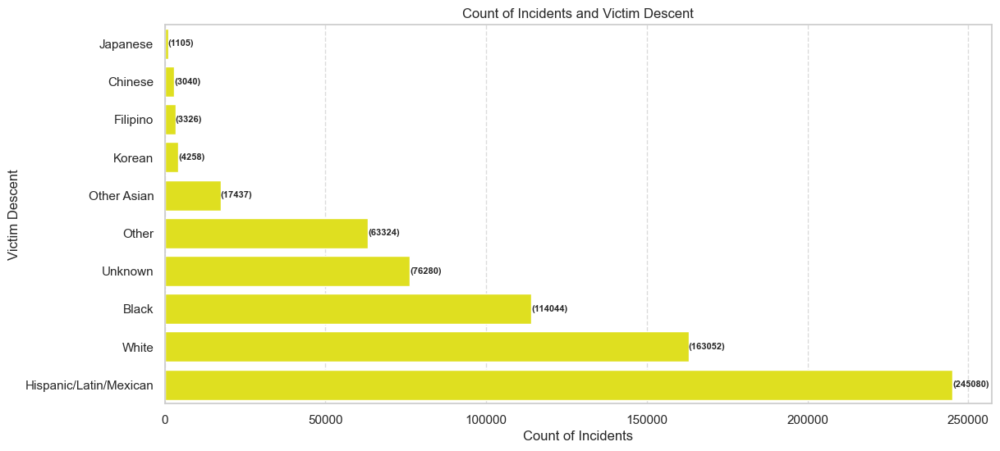

In [62]:
## Define the VictimDescentAbbr and VictimDescentDescription lists
VictimDescentAbbr = ["A", "B", "C", "D", "F", "G", "H", "I", "J", "K", "L", "O", "P", "S", "U", "V", "W", "X", "X`", "Z"]
VictimDescentDescription = ["Other Asian", "Black", "Chinese", "Cambodian", "Filipino", "Guamanian", "Hispanic/Latin/Mexican",
                            "American Indian/Alaskan Native", "Japanese", "Korean", "Laotian", "Other", "Pacific Islander",
                            "Samoan", "Hawaiian", "Vietnamese", "White", "Unknown", "Null Unknown", "AsianIndian"]

# Create a DataFrame for VictimDescentFull
VictimDescentFull = pd.DataFrame({'VictimDescent': VictimDescentAbbr, 'VictimDescentDescription': VictimDescentDescription})

# Assuming you have a DataFrame named LACrime with 'VictimDescent' column

# Filter out rows with non-null 'VictimDescent'
filtered_data = cleaned_df[cleaned_df['VictimDescent'] != 'X`']

# Group by 'VictimDescent' and calculate the count of incidents
summary_decent = filtered_data['VictimDescent'].value_counts().reset_index()
summary_decent.columns = ['VictimDescent', 'n']

# Sort the DataFrame by 'n' in descending order and select the top 10 rows
summary_decent = summary_decent.sort_values(by='n', ascending=False).head(10)

# Merge the summary DataFrame with VictimDescentFull to get the description
summary_decent = pd.merge(summary_decent, VictimDescentFull, on='VictimDescent', how='inner')

# Create the bar plot
pyplot.figure(figsize=(13, 6))
sns.set(style="whitegrid")
sns.barplot(x='n', y='VictimDescentDescription', data=summary_decent, color='yellow')

# Add count labels to the bars
for index, value in enumerate(summary_decent['n']):
    pyplot.text(value, index, f"({value})", va='center', fontsize=8, fontweight='bold')

# Set labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Victim Descent')
pyplot.title('Count of Incidents and Victim Descent')

# Show the plot
pyplot.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top
pyplot.grid(axis='x', linestyle='--', alpha=0.7)
pyplot.show()

In [63]:
# Proportion of victims sorted in descenting order for the 
cleaned_df['VictimDescent'].value_counts(normalize= True)[:10]

VictimDescent
H     0.307051
W     0.204282
B     0.142881
X`    0.131124
X     0.095568
O     0.079336
A     0.021846
K     0.005335
F     0.004167
C     0.003809
Name: proportion, dtype: float64

In [64]:
descent_dict

{'A': 'Other Asian',
 'B': 'Black',
 'C': 'Chinese',
 'D': 'Cambodian',
 'F': 'Filipino',
 'G': 'Guamanian',
 'H': 'Latinx',
 'I': 'Native',
 'J': 'Japanese',
 'K': 'Korean',
 'L': 'Laotian',
 'O': 'Other',
 'P': 'Pacific Islander',
 'S': 'Samoan',
 'U': 'Hawaiian',
 'V': 'Vietnamese',
 'W': 'White',
 'X': 'Unknown',
 'X`': 'Null Unknown',
 'Z': 'Asian Indian'}

For all the crimes reported from January 2020 to September 2023,
31% are Latinx decent, 
20% are White,and 
14% are Black.

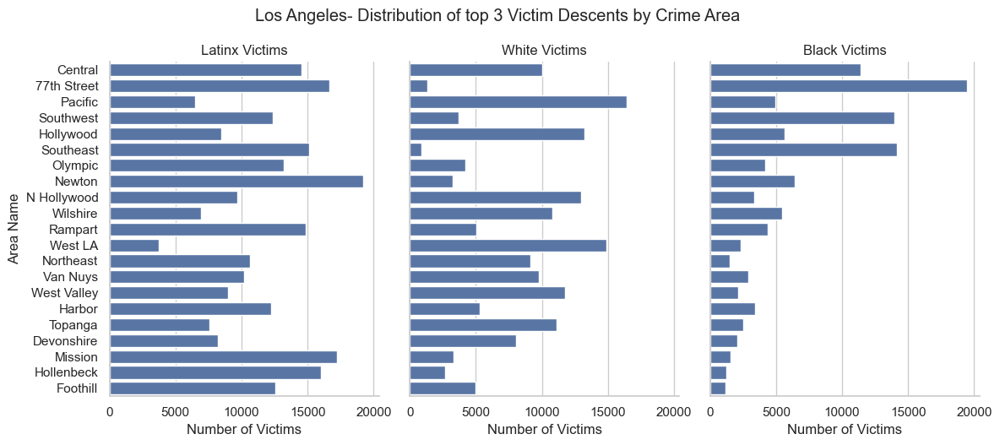

In [65]:
# Plotting a categorical estimate plot of Crime area by Descent
g = sns.catplot(y="AreaName", col="VictimDescent",
                col_order= cleaned_df['VictimDescent'].value_counts()[:3].index
                ,data=cleaned_df, kind="count",height=5, aspect=.8,
               order=cleaned_df['AreaName'].value_counts().index)

# Setting label an title for first facet
g.axes[0,0].set_xlabel('Number of Victims')
g.axes[0,0].set_title('Latinx Victims')

# # Setting label an title for second facet
# g.axes[0,1].set_xlabel('Number of Victims')
# g.axes[0,1].set_title('Unknown Victims')

# Setting label an title for third facet
g.axes[0,1].set_xlabel('Number of Victims')
g.axes[0,1].set_title('White Victims')

# Setting label an title for fourth facet
g.axes[0,2].set_xlabel('Number of Victims')
g.axes[0,2].set_title('Black Victims')

#setting figure title for facetgrid plot
g.fig.suptitle('Los Angeles- Distribution of top 3 Victim Descents by Crime Area ', y = 1.05);
g.set_ylabels('Area Name')

Looking at the top 3 vulneratble demographics in LA, Black and Latinx communities has most suffered in the highest crime occurring areas off 77th Street and Southeast. This could also be that there are lesser wWhite people living in these two areas. White victims are highest Pacific area, West LA and Hollywood, this could be because these areas have higher white population. Similarly, areas such as Mission, Newton, Rampart, Foothill and Hollenbeck have a higher number of Latinx victims than the other descents.

## Analysis of Weapon used in Crime

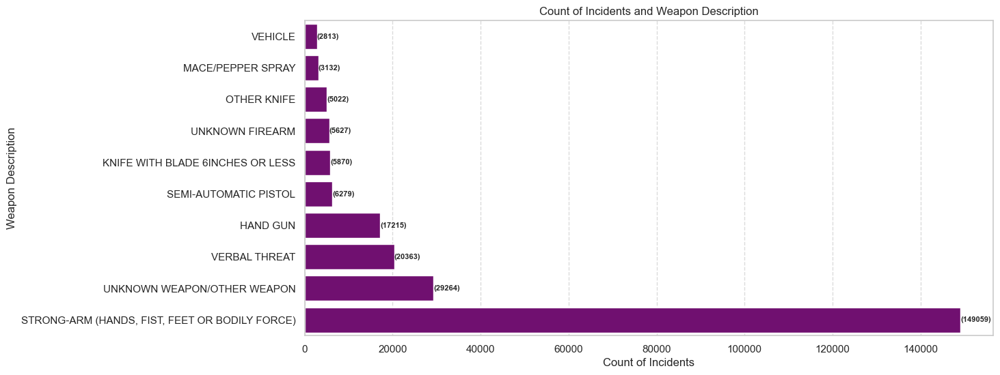

In [66]:
# droping the rows that have UNKNOWN 'WeaponDescription'
filtered_data = cleaned_df[cleaned_df['WeaponDescription'] != 'UNKNOWN']

# grouping by 'WeaponDescription' and calculating the count of incidents
summary_weapon = filtered_data['WeaponDescription'].value_counts().reset_index()
summary_weapon.columns = ['WeaponDescription', 'n']

# sorting the DataFrame by 'n' in descending order and selecting the top 10 rows
summary_weapon = summary_weapon.sort_values(by='n', ascending=False).head(10)

# creating the bar plot
pyplot.figure(figsize=(13, 6))
sns.set(style="whitegrid")
sns.barplot(x='n', y='WeaponDescription', data=summary_weapon, color='purple')

# adding count labels to the bars
for index, value in enumerate(summary_weapon['n']):
    pyplot.text(value, index, f"({value})", va='center', fontsize=8, fontweight='bold')

# adding labels and title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Weapon Description')
pyplot.title('Count of Incidents and Weapon Description')

# show the plot
pyplot.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top
pyplot.grid(axis='x', linestyle='--', alpha=0.7)
pyplot.show()

We can observe that No weapon has been used for most of the crimes.This also means that most of the crimes are not directly life-threatening

## How Much Has Crime Fluctuated in the Last 3 Years?

### Types of Crime Analysis

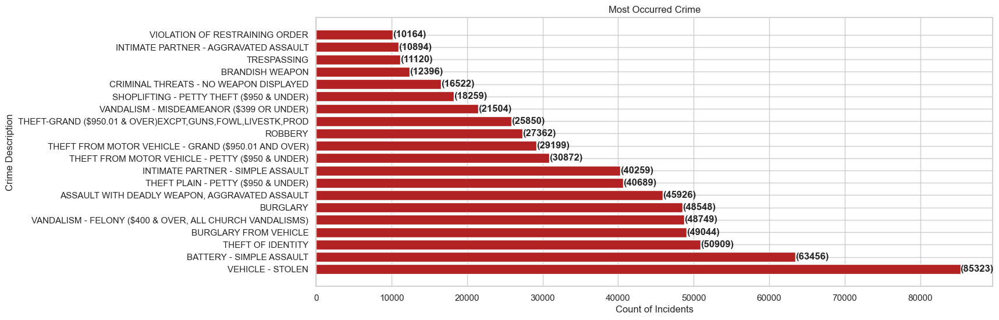

In [67]:
# grouping by 'CrimeCodeDescription' and calculating the count of incidents
summary_crime = cleaned_df.groupby('CrimeCodeDescription').size().reset_index(name='CountIncidents')

# sorting the DataFrame by count of incidents in descending order and taking the top 20
summary_crime = summary_crime.sort_values(by='CountIncidents', ascending=False).head(20)

# reordering 'CrimeCodeDescription' based on the count of incidents
summary_crime['CrimeCodeDescription'] = pd.Categorical(summary_crime['CrimeCodeDescription'], categories=summary_crime['CrimeCodeDescription'], ordered=True)

# creating the bar plot
pyplot.figure(figsize=(15, 6))
pyplot.barh(summary_crime['CrimeCodeDescription'], summary_crime['CountIncidents'], color='firebrick')

# adding count labels to the bars
for index, value in enumerate(summary_crime['CountIncidents']):
    pyplot.text(value, index, f"({value})", va='center', fontsize=12, fontweight='bold')

# adding axis labels and plot title
pyplot.xlabel('Count of Incidents')
pyplot.ylabel('Crime Description')
pyplot.title('Most Occurred Crime')

# show the plot
pyplot.show()

### Crime Trend in the Last 3 Years

In [68]:
# grouping data by date in index
crime_volume = pd.DataFrame(cleaned_df.groupby(cleaned_df.index.date).size(), columns=['crime_count']).reset_index()

# pulling out date from index to convert to datetime object
crime_volume.rename(columns = {'index':'Date'}, inplace = True)

# converting Date column to datetime object
crime_volume['Date']= pd.to_datetime(crime_volume['Date'], format='%Y-%m-%d')

# setting datetime object as index
crime_volume.set_index('Date', inplace=True)

# resample monthly average crime from datetime index
monthly_crime=round(crime_volume.resample('MS').mean(),2)

In [69]:
# grouping data annually
year_groups= monthly_crime.groupby(pd.Grouper(freq='A'))

# create a new DataFrame and store yearly values in columns 
annual_crime = pd.DataFrame()

# looping through the year_unemp groupby object as a tuple
for date,group in year_groups:
    year = date.year          #pulling the year from datetime object
    if year == 2023:          # removing year for incomplete data
        break
    series = group.values.ravel()  # flattening the array
    annual_crime[year] = series

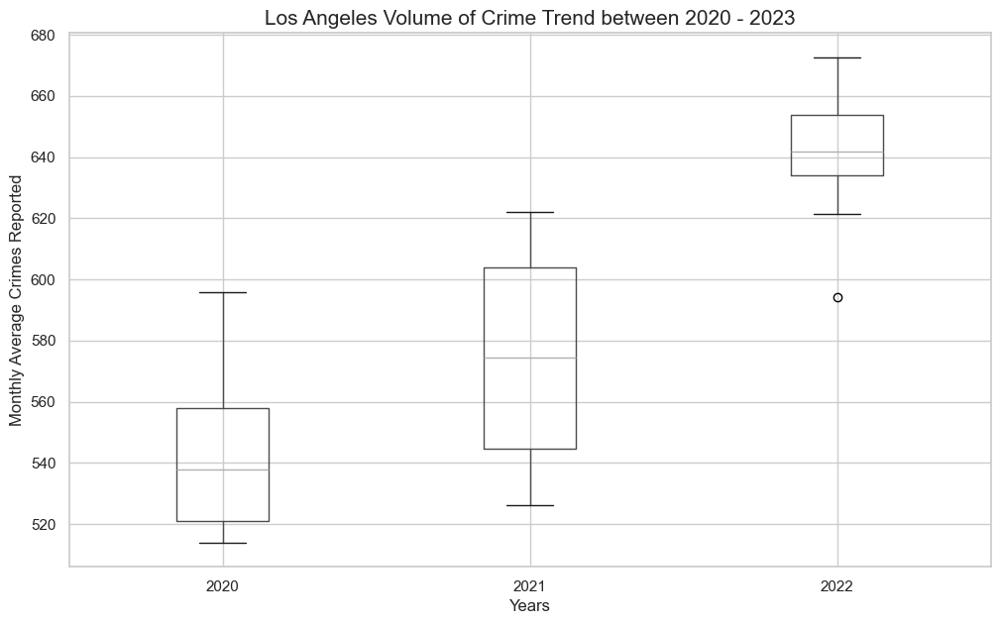

In [70]:
# generating a box and whiskers plot for last 10 years
annual_crime.boxplot(figsize=(12,7))

# setting figure title
pyplot.title('Los Angeles Volume of Crime Trend between 2020 - 2023', size = 15)

# setting x and y label
pyplot.xlabel('Years', size=12)
pyplot.ylabel('Monthly Average Crimes Reported', size = 12)

# display graph
pyplot.show();

The Average monthly crime in the period between 2020 to 2022. I intentionally skipped the 2023 as the data was collected till September 2023.
Here, 2020 to 2022 ranges between 520 crimes per month to 650 crimes per month. We can see that 2022 saw the highest average number of crimes reported, while the Covid Year 2022 saw the lowest average number of crimes in LA.

## Word Cloud

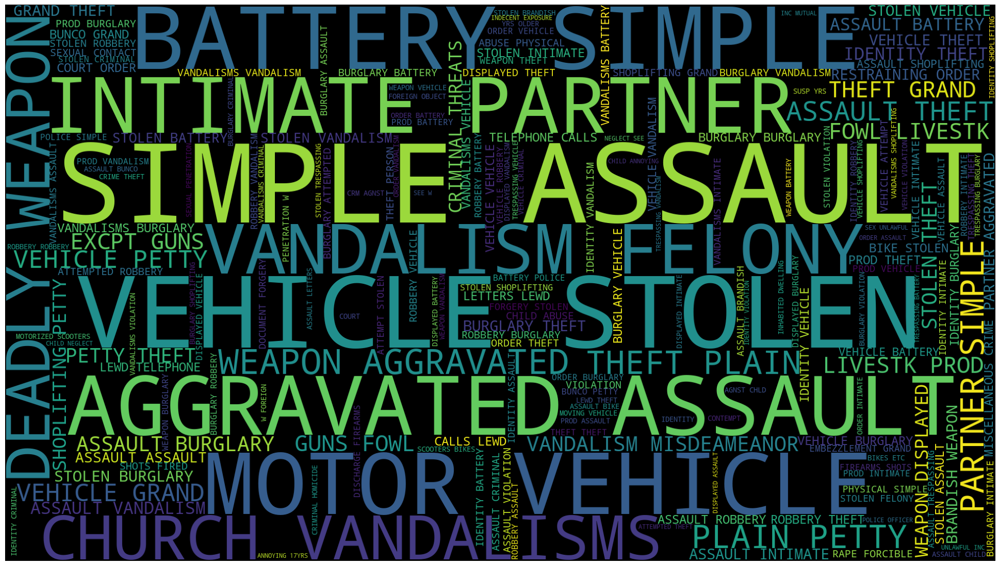

In [71]:
from wordcloud import WordCloud

pyplot.figure(figsize=(25,15))
wordcloud = WordCloud(
    background_color = 'black',
    width=1920,
    height=1080,
).generate(" ".join(cleaned_df.CrimeCodeDescription))
pyplot.imshow(wordcloud)
pyplot.axis('off')
pyplot.show()

                                    Word Cloud Showing the Type of Crime According to Count

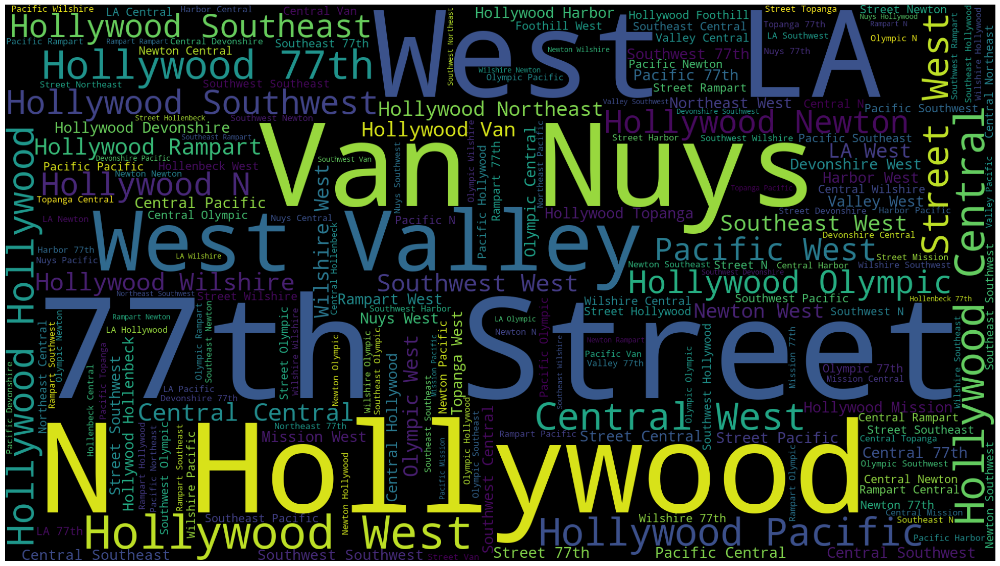

In [72]:
pyplot.figure(figsize=(25,15))
wordcloud = WordCloud(
    background_color = 'black',
    width=1920,
    height=1080,
).generate(" ".join(cleaned_df.AreaName))
pyplot.imshow(wordcloud)
pyplot.axis('off')
pyplot.show()

                                    Word Cloud Showing the Area Names According to Count

## Map the Crime Sites

In [73]:
# calculating the center longitude and latitude
center_lon = cleaned_df['Lon'].median(skipna=True)
center_lat = cleaned_df['Lat'].median(skipna=True)

# taking sample a subset of data (50,000 random rows) from the DataFrame
cleaned_df_for_map = cleaned_df.sample(n=50000, random_state=42)

# creating a folium map centered at the calculated coordinates
map = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# adding Esri NatGeo World Map tiles
folium.TileLayer(tiles="http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/tile/{z}/{y}/{x}",
                 attr="Esri", name="Esri NatGeo").add_to(map)

# adding circles to the map for each point in the sampled data
for index, row in cleaned_df_for_map.iterrows():
    folium.CircleMarker(
        location=[row['Lat'], row['Lon']],
        radius=5,
        color='red',
    ).add_to(map)

# show the map
map

                                            Map Showing the Crime Location (Red Marke are Crime Location)

## Monthly Crime Count Trend

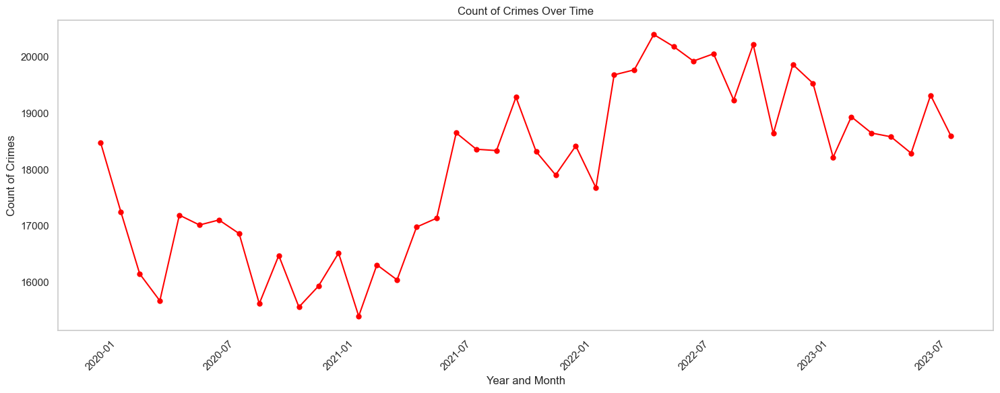

In [80]:
# Extract year and month from 'DateOccurred'
cleaned_df_for_trend = cleaned_df[cleaned_df['year_month'] <= '2023-08-31']
cleaned_df_for_trend['year_month'] = cleaned_df_for_trend.index.to_period('M')

# Group by 'year_month' and calculate the count of crimes
crime_grouped = cleaned_df_for_trend.groupby('year_month')['year_month'].count().reset_index(name='CountCrimes')

# Filter out rows with 'year_month' not equal to "2023-09-01"
crime_grouped = crime_grouped[crime_grouped['year_month'] != pd.Period('2023-12', 'M')]

# Create the line plot
pyplot.figure(figsize=(15, 6))
pyplot.plot(crime_grouped['year_month'].dt.to_timestamp(), crime_grouped['CountCrimes'], marker='o', color='red', linestyle='-', markersize=5)

# Set axis labels and plot title
pyplot.xlabel('Year and Month')
pyplot.ylabel('Count of Crimes')
pyplot.title('Count of Crimes Over Time')

# Rotate x-axis labels for readability
pyplot.xticks(rotation=45)

# Show the plot
pyplot.grid()
pyplot.tight_layout()
pyplot.show()

# Prediction
Splitting original data to train set and test set, to run Linear Regression, Auto Regression and Moving Average models

In [81]:
# grouping data by date in index
crime_volume = pd.DataFrame(cleaned_df.groupby(cleaned_df.index.date).size(), columns=['crime_count']).reset_index()

# pulling out date from index to convert to datetime object
crime_volume.rename(columns = {'index':'Date'}, inplace = True)

# converting Date column to datetime object
crime_volume['Date']= pd.to_datetime(crime_volume['Date'], format='%Y-%m-%d')

# setting datetime object as index
crime_volume.set_index('Date', inplace=True)

# resample daily average crime from datetime index
daily_crime =round(crime_volume.resample('D').sum())

# model evaluation
model_evaluation = {}

In [82]:
daily_crime

,crime_count
Date,
2020-01-01,1100
2020-01-02,526
2020-01-03,595
2020-01-04,540
2020-01-05,505
...,...
2023-09-07,451
2023-09-08,458
2023-09-09,498


### Linear Regression Model (LR)

In [83]:
df_l = daily_crime
# daily crime count
df_l['Day'] = np.arange(len(daily_crime.index))

# Separate features (X) and target variable (y)
X = df_l.loc[:, ['Day']]
y = df_l.loc[:, ['crime_count']]

# Shuffle and split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [87]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [88]:
model_pred = model.predict(X_test)

In [93]:
mae = mean_absolute_error(model_pred, y_test)
mse = mean_squared_error(model_pred, y_test)
rmse = math.sqrt(mse)

#adding mae, mse, rmse eval to model_evaluation dict
model_evaluation['LR_MAE:'] = mae
model_evaluation['LR_MSE:'] = mse
model_evaluation['LR_RMSE:'] = rmse

print('The Mean Absolute Error of prediction is {}'.format(round(mae,2)))
print('The Mean Squared Error of predictions is {}'.format(round(mse,2)))
print('The Root Mean Squared Error of predictions is {}'.format(round(rmse, 2)))

The Mean Absolute Error of prediction is 57.02
The Mean Squared Error of predictions is 8364.99
The Root Mean Squared Error of predictions is 91.46


### Autoregressive Model (AR)

In [94]:
# daily crime count
Xo = daily_crime.index
# target
Yo = daily_crime['crime_count']

train_seto = monthly_crime.loc['2020-01-01':'2022-12-31']
test_seto = monthly_crime.loc['2023-01-01':]

X_traino, X_testo = train_seto.index, test_seto.index
y_traino, y_testo = train_seto['crime_count'], test_seto['crime_count']

In [95]:
# instantiate an AR(1) model to the simulated data
model_ar = ARIMA(y_traino, order=(1,0,0))

# fitting model
res_ar = model_ar.fit()

In [96]:
# Get predictions starting from 2023-01-01 and calculate confidence intervals
pred = res_ar.predict(start='2023-01-01', end='2023-09-01',dynamic=False)

In [99]:
# Compute the mean average error
mae = mean_absolute_error(y_testo, pred)

# Compute the mean squared error
mse = mean_squared_error(y_testo, pred)

# Compute the root mean square error
rmse = np.sqrt(((pred - y_testo)**2).mean())

#adding mae, mse, rmse eval to model_evaluation dict
model_evaluation['AR_mae']= mae
model_evaluation['AR_mse']= mse
model_evaluation['AR_rmse']= rmse

print('The Mean Absolute Error of prediction is {}'.format(round(mae,2)))
print('The Mean Squared Error of predictions is {}'.format(round(mse,2)))
print('The Root Mean Squared Error of predictions is {}'.format(round(rmse, 2)))

The Mean Absolute Error of prediction is 24.02
The Mean Squared Error of predictions is 1790.86
The Root Mean Squared Error of predictions is 42.32


### Moving-Average Model (MA)

In [100]:
# instantiate an MA(1) model to the simulated data
model_ma = ARIMA(y_traino, order=(0,0,1))

# fitting model
res_ma = model_ma.fit()

In [101]:
# Get predictions starting from 2023-01-01 and calculate confidence intervals
pred = res_ma.predict(start='2023-01-01', end='2023-09-01',dynamic=False)

In [104]:
# Compute the mean average error
mae = mean_absolute_error(y_testo, pred)

# Compute the mean squared error
mse = mean_squared_error(y_testo, pred)

# Compute the root mean square error
rmse = np.sqrt(((pred - y_testo)**2).mean())

#adding mae, mse, rmse eval to model_evaluation dict
model_evaluation['MA_mae']= mae
model_evaluation['MA_mse']= mse
model_evaluation['MA_rmse']= rmse

print('The Mean Absolute Error of prediction is {}'.format(round(mae,2)))
print('The Mean Squared Error of predictions is {}'.format(round(mse,2)))
print('The Root Mean Squared Error of predictions is {}'.format(round(rmse, 2)))

The Mean Absolute Error of prediction is 33.64
The Mean Squared Error of predictions is 1912.75
The Root Mean Squared Error of predictions is 43.74


### Autoregressive Integrated Moving Average (ARIMA)

In [105]:
# instantiate an ARIMA model to the simulated data
model_arima = ARIMA(y_traino, order=(1,1,1))

# fitting model
res_arima = model_arima.fit()

In [106]:
# Get predictions starting from 2023-01-01 and calculate confidence intervals
pred = res_arima.predict(start='2023-01-01', end='2023-09-01',dynamic=False)

In [ ]:
pred

In [108]:
# Compute the mean average error
mae = mean_absolute_error(y_testo, pred)

# Compute the mean squared error
mse = mean_squared_error(y_testo, pred)

# Compute the root mean square error
rmse = np.sqrt(((pred - y_testo)**2).mean())

#adding mae, mse, rmse eval to model_evaluation dict
model_evaluation['ARIMA_mae']= mae
model_evaluation['ARIMA_mse']= mse
model_evaluation['ARIMA_rmse']= rmse

print('The Mean Absolute Error of prediction is {}'.format(round(mae,2)))
print('The Mean Squared Error of predictions is {}'.format(round(mse,2)))
print('The Root Mean Squared Error of predictions is {}'.format(round(rmse, 2)))

The Mean Absolute Error of prediction is 38.62
The Mean Squared Error of predictions is 3151.03
The Root Mean Squared Error of predictions is 56.13


In [109]:
model_evaluation

{'LR_MAE:': 57.01576001151568,
 'LR_MSE:': 8364.992660237735,
 'LR_RMSE:': 91.4603338078193,
 'AR_mae': 24.02425833496381,
 'AR_mse': 1790.8564403718165,
 'AR_rmse': 42.318511792970895,
 'MA_mae': 33.63561564521592,
 'MA_mse': 1912.7518384403504,
 'MA_rmse': 43.73501844563862,
 'ARIMA_mae': 38.61754741039869,
 'ARIMA_mse': 3151.034997886308,
 'ARIMA_rmse': 56.13408053835306}

### Took help from these:
1. https://www.kaggle.com/code/ambarish/eda-lacrimes-maps-timeseriesforecasts-xgboost
2. https://www.kaggle.com/code/ismailsefa/crimes-data-analysis-and-visualization-eda/notebook
3. https://www.kaggle.com/code/yannisp/sf-crime-analysis-prediction
4. https://www.kaggle.com/code/jmortin/crime-prediction-sf-a-different-take
5. https://www.kaggle.com/code/leccisandro/crime-prediction-linearregression-ridge
6. https://www.kaggle.com/datasets/cityofLA/crime-in-los-angeles
7. https://github.com/alexarnold630/Dallas_Crime_Analysis_and_Prediction
8. https://github.com/rifat1234/EDA-of-Dallas-Texas-Crime-/tree/main
9. https://github.com/sidneykung/LA_crime_forecasting
10. https://www.slideshare.net/HetaParekh1/crime-data-analysis-and-prediction-for-city-of-los-angeles
11. https://storymaps.arcgis.com/stories/e1a9166fe2b649af8d8757476ade0b6a
12. https://medium.com/analytics-vidhya/los-angeles-crime-data-analysis-using-pandas-a68780d80a83